In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import folium
from folium.plugins import HeatMap


import seaborn as sns
import warnings
import calendar

warnings.filterwarnings("ignore")

In [3]:
accidentes= pd.read_csv('./DATA/accidentes.csv')


In [86]:
accidentes

,ID,VICTIMAS,FECHA,ANIO,MES,DIA,HORA,MEDIO,COMUNA,X,Y,PARTICIPANTES,ACUSADO,ROL,DAMNIFICADO,SEXO,EDAD,OBITO
0,2016-0001,1,2016-01-01,2016,1,1,04:00:00,AVENIDA,8,-58.475340,-34.687570,MOTO-AUTO,AUTO,CONDUCTOR,MOTO,MASCULINO,19,1
1,2016-0002,1,2016-01-02,2016,1,2,01:15:00,AUTOPISTA,9,-58.508775,-34.669777,AUTO-PASAJEROS,PASAJEROS,CONDUCTOR,AUTO,MASCULINO,70,1
2,2016-0003,1,2016-01-03,2016,1,3,07:00:00,AVENIDA,1,-58.390403,-34.631894,MOTO-AUTO,AUTO,CONDUCTOR,MOTO,MASCULINO,30,1
3,2016-0004,1,2016-01-10,2016,1,10,00:00:00,AVENIDA,8,-58.465039,-34.680930,MOTO-SD,DESCONOCIDO,CONDUCTOR,MOTO,MASCULINO,18,1
4,2016-0005,1,2016-01-21,2016,1,21,05:20:00,AVENIDA,1,-58.387183,-34.622466,MOTO-PASAJEROS,PASAJEROS,CONDUCTOR,MOTO,MASCULINO,29,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26556,LC-2021-0652849,1,2021-12-31,2021,12,31,19:30:00,AVENIDA,9,-58.513477,-34.659714,MOTO,DESCONOCIDO,DESCONOCIDO,DESCONOCIDO,MASCULINO,29,0
26557,LC-2021-0652865,2,2021-12-31,2021,12,31,19:40:00,AVENIDA,9,-58.488327,-34.641753,MOTO,DESCONOCIDO,DESCONOCIDO,DESCONOCIDO,MASCULINO,28,0
26558,LC-2021-0652865,2,2021-12-31,2021,12,31,19:40:00,AVENIDA,9,-58.488327,-34.641753,MOTO,DESCONOCIDO,DESCONOCIDO,DESCONOCIDO,MASCULINO,52,0
26559,LC-2021-0652907,1,2021-12-31,2021,12,31,20:00:00,DESCONOCIDO,1,-58.382894,-34.583083,MOTO,DESCONOCIDO,DESCONOCIDO,DESCONOCIDO,MASCULINO,23,0


In [92]:
accidentes_obitos= accidentes[accidentes['OBITO'] == 1].copy()
accidentes_lesiones= accidentes[accidentes['OBITO'] == 0].copy()



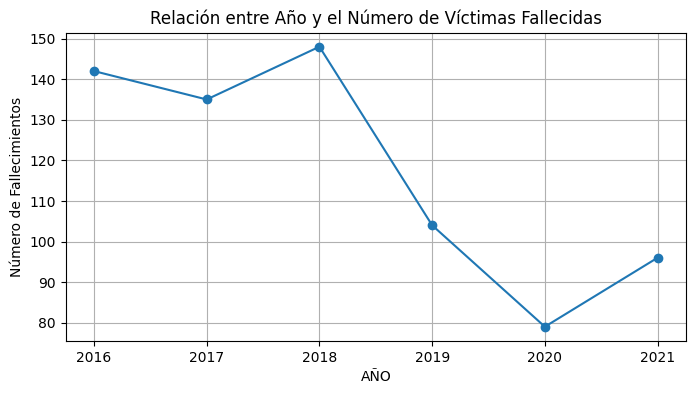

In [94]:
victimas_anual = accidentes_obitos.groupby('ANIO')['VICTIMAS'].count().reset_index()

plt.figure(figsize=(8, 4))
plt.plot(victimas_anual['ANIO'], victimas_anual['VICTIMAS'], marker='o', linestyle='-')
plt.title('Relación entre Año y el Número de Víctimas Fallecidas')
plt.xlabel('AÑO')
plt.ylabel('Número de Fallecimientos')
plt.grid(True)

plt.show()

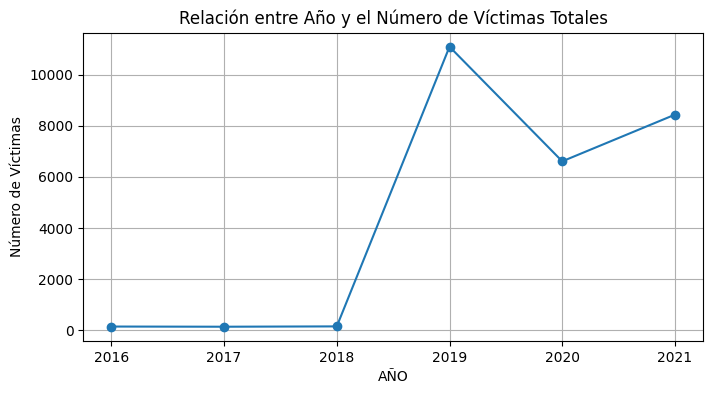

In [95]:
victimas_anual = accidentes.groupby('ANIO')['VICTIMAS'].count().reset_index()

plt.figure(figsize=(8, 4))
plt.plot(victimas_anual['ANIO'], victimas_anual['VICTIMAS'], marker='o', linestyle='-')
plt.title('Relación entre Año y el Número de Víctimas Totales')
plt.xlabel('AÑO')
plt.ylabel('Número de Víctimas')
plt.grid(True)

plt.show()

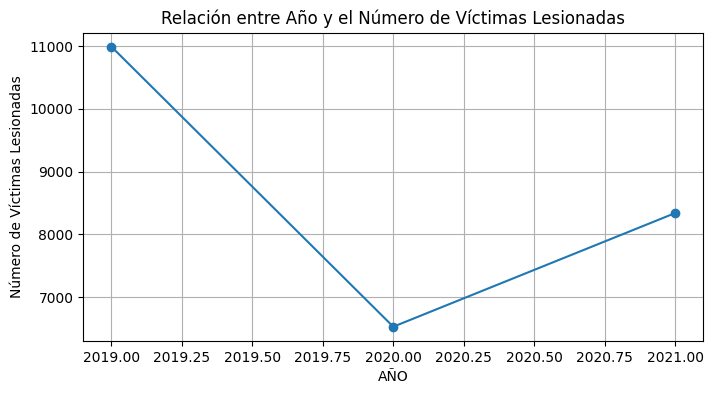

In [96]:
victimas_anual = accidentes_lesiones.groupby('ANIO')['VICTIMAS'].count().reset_index()

plt.figure(figsize=(8, 4))  # Ajusta el tamaño de la gráfica según tus preferencias
plt.plot(victimas_anual['ANIO'], victimas_anual['VICTIMAS'], marker='o', linestyle='-')
plt.title('Relación entre Año y el Número de Víctimas Lesionadas')
plt.xlabel('AÑO')
plt.ylabel('Número de Víctimas Lesionadas')
plt.grid(True)

plt.show()

In [4]:
mapa = accidentes.loc[accidentes['OBITO'] == 1, ['X', 'Y']]
mapa = mapa.dropna(subset=['X', 'Y'])
print(mapa)

             X          Y
0   -58.475340 -34.687570
1   -58.508775 -34.669777
2   -58.390403 -34.631894
3   -58.465039 -34.680930
4   -58.387183 -34.622466
..         ...        ...
699 -58.433538 -34.645616
700 -58.467398 -34.651178
701 -58.472934 -34.619847
702 -58.470668 -34.650217
703 -58.379762 -34.586796

[704 rows x 2 columns]


In [68]:
mapa = mapa.dropna(subset=['X', 'Y'])

centro_mapa = [mapa['Y'].mean(), mapa['X'].mean()]
mapa_obitos = folium.Map(location=centro_mapa, zoom_start=12)
heat_data = [[row['Y'], row['X']] for index, row in mapa.iterrows()]
HeatMap(heat_data, radius=17, cmap='inferno', gradient={.5: 'purple', .6: 'blue', 1: 'red'}).add_to(mapa_obitos)

mapa_obitos.save('mapa_obitos.html')

In [69]:
mapa_obitos

In [84]:
mapa1 = accidentes[['X', 'Y', 'OBITO']].copy()

mapa1 = mapa1.dropna(subset=['X', 'Y'])

In [85]:
mapa1

,X,Y,OBITO
0,-58.475340,-34.687570,1
1,-58.508775,-34.669777,1
2,-58.390403,-34.631894,1
3,-58.465039,-34.680930,1
4,-58.387183,-34.622466,1
...,...,...,...
26556,-58.513477,-34.659714,0
26557,-58.488327,-34.641753,0
26558,-58.488327,-34.641753,0
26559,-58.382894,-34.583083,0


In [107]:
centro_mapa = [mapa1['Y'].mean(), mapa1['X'].mean()]
mapaObitosyLesiones = folium.Map(location=centro_mapa, zoom_start=13)

for index, row in mapa1.iterrows():
    if row['OBITO'] == 1:
        radius = 10  
        color = 'red'
    else:
        radius = .8
        color = 'blue'
    folium.CircleMarker(
        location=[row['Y'], row['X']],
        radius=radius,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.4,
        popup=f"Ubicación: {row['Y']}, {row['X']}\nOBITO: {row['OBITO']}"
    ).add_to(mapaObitosyLesiones)

mapaObitosyLesiones.save('mapaObitosyLesiones.html')

In [108]:
mapaObitosyLesiones